In [1]:
import numpy as np
import os
import matplotlib.pyplot as plt
from ipywidgets import interact, IntSlider
import imageio
from IPython.display import Image
from scipy.spatial.distance import cdist

In [2]:
path_tp = 'Triple_points_pos/'
path_adj = 'Adj_matrix/'
num_time_stamps = 59

In [3]:
tp = {}
adj_mat = {}
for i in range(1,60):
    name = str(i) + '.txt'
    tp_name = path_tp + name
    adj_name = path_adj + name
    tp[i] = np.loadtxt(tp_name)
    adj_mat[i] = np.loadtxt(adj_name)
    

## Node data

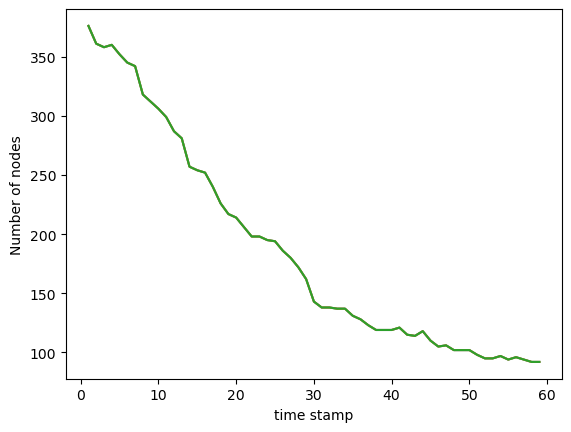

In [6]:
num_tp = np.array([len(tp[i]) for i in range(1,60)])
timestamp = np.array([i for i in range(1,60)])
plt.plot(timestamp, num_tp)
plt.xlabel('time stamp')
plt.ylabel('Number of nodes')
plt.savefig("Images/node_count.png")
plt.show()

In [6]:
num_tp.min(), num_tp.max()

(92, 376)

In [7]:
print("In the following exmples, the number of nodes is slightly higher than the previous node count is as follows")
print("index, num nodes, num future nodes")
for i in range(58):
    if num_tp[i] < num_tp[i+1]:
        print(i, num_tp[i], num_tp[i+1])

In the following exmples, the number of nodes is slightly higher than the previous node count is as follows
index, num nodes, num future nodes
2 358 360
39 119 121
42 114 118
45 105 106
52 95 97
54 94 96


In [8]:
print("In the following exmples, the number of nodes is equal previous node count is as follows")
print("index, num nodes, num future nodes")
for i in range(58):
    if num_tp[i] == num_tp[i+1]:
        print(i, num_tp[i], num_tp[i+1])

In the following exmples, the number of nodes is equal previous node count is as follows
index, num nodes, num future nodes
21 198 198
30 138 138
32 137 137
37 119 119
38 119 119
47 102 102
48 102 102
51 95 95
57 92 92


## Interactive plots

In [9]:
class grain_img():
    def __init__(self, tp, adj):
        self.tp = tp
        self.adj = adj
        
    def grain_plot(self, ind):
        edge = np.array(np.where(self.adj[ind] == 1))
        _, l = len(edge), len(np.transpose(edge))
        new = np.sort(np.transpose(edge))
        
        fig = plt.figure(figsize=(15,15))
        ax = fig.add_subplot()
        ax.scatter(self.tp[ind][:,0], self.tp[ind][:,1])
        for i in range(len(self.tp[ind])):
            plt.annotate(i,[self.tp[ind][i,0],self.tp[ind][i,1]])
        for i in range(l):
            val1 = [self.tp[ind][new[i,0],1], self.tp[ind][new[i,1],1]]
            val2 = [self.tp[ind][new[i,0],0], self.tp[ind][new[i,1],0]]
            #print(val1,val2)
            #print("\n")
            ax.plot(val2,val1)
            #plt.show()
        ax.set_aspect('equal', adjustable='box')
        #plt.savefig(f'plot_{ind}.png')
        plt.show()              
      
    
    
    def plot_upd(self, n):
        plt.clf()
        self.grain_plot(n)
        
    def plotly_grain_plot(self):
        slider = IntSlider(min=1, max=59, step=1, value=1)
        interact(self.plot_upd, n=slider)

In [10]:
plotter = grain_img(tp, adj_mat)
plotter.plotly_grain_plot()

interactive(children=(IntSlider(value=1, description='n', max=59, min=1), Output()), _dom_classes=('widget-int…

In [11]:
def save_plots(tp, adj):
    for ind in range(1,60):
        edge = np.array(np.where(adj[ind] == 1))
        _, l = len(edge), len(np.transpose(edge))
        new = np.sort(np.transpose(edge))
        
        fig = plt.figure(figsize=(15,15))
        ax = fig.add_subplot()
        ax.scatter(tp[ind][:,0],tp[ind][:,1])
        #for i in range(len(tp[ind])):
            #plt.annotate(i,[tp[ind][i,0],tp[ind][i,1]])
        for i in range(l):
            val1 = [tp[ind][new[i,0],1], tp[ind][new[i,1],1]]
            val2 = [tp[ind][new[i,0],0], tp[ind][new[i,1],0]]
            #print(val1,val2)
            #print("\n")
            ax.plot(val2,val1)
            #plt.show()
        ax.set_aspect('equal', adjustable='box')
        ax.set_xlim(0,210)
        ax.set_ylim(0,210)
        plt.savefig(f'plots/plot_{ind}.png')
        plt.show()           
    

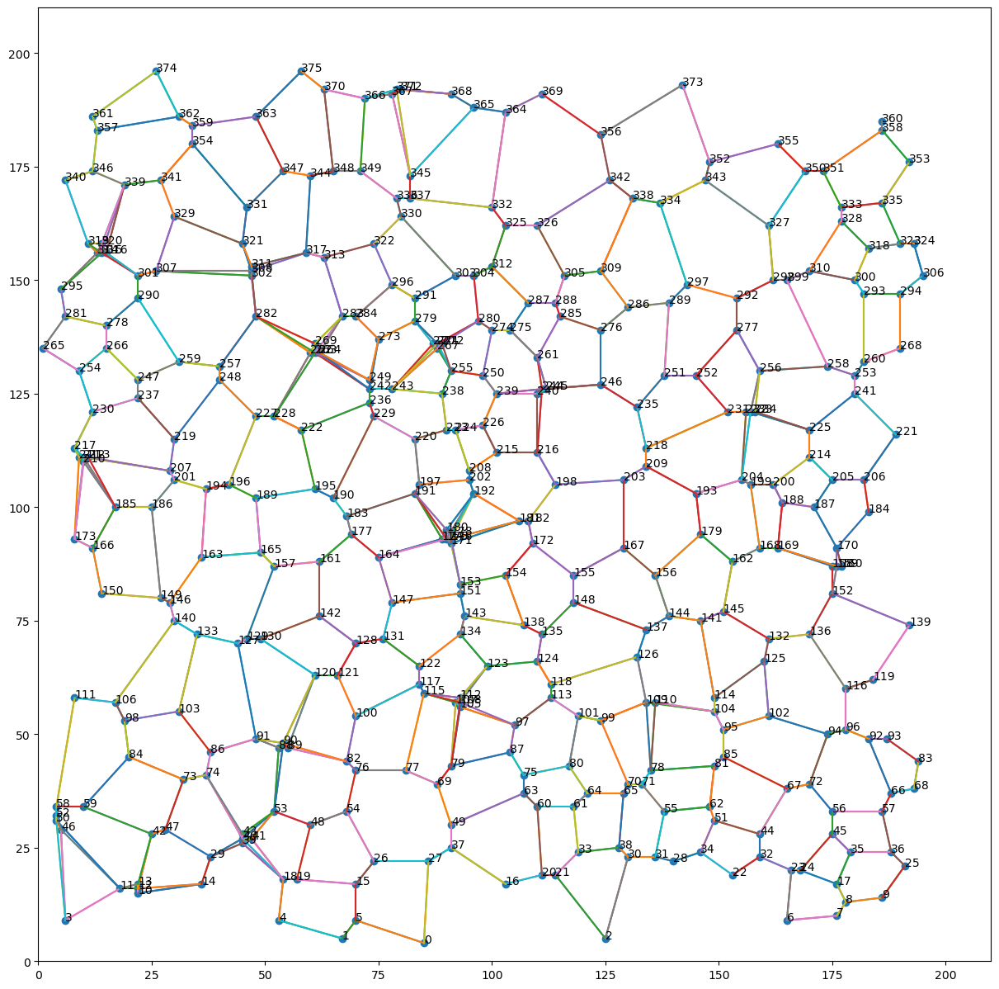

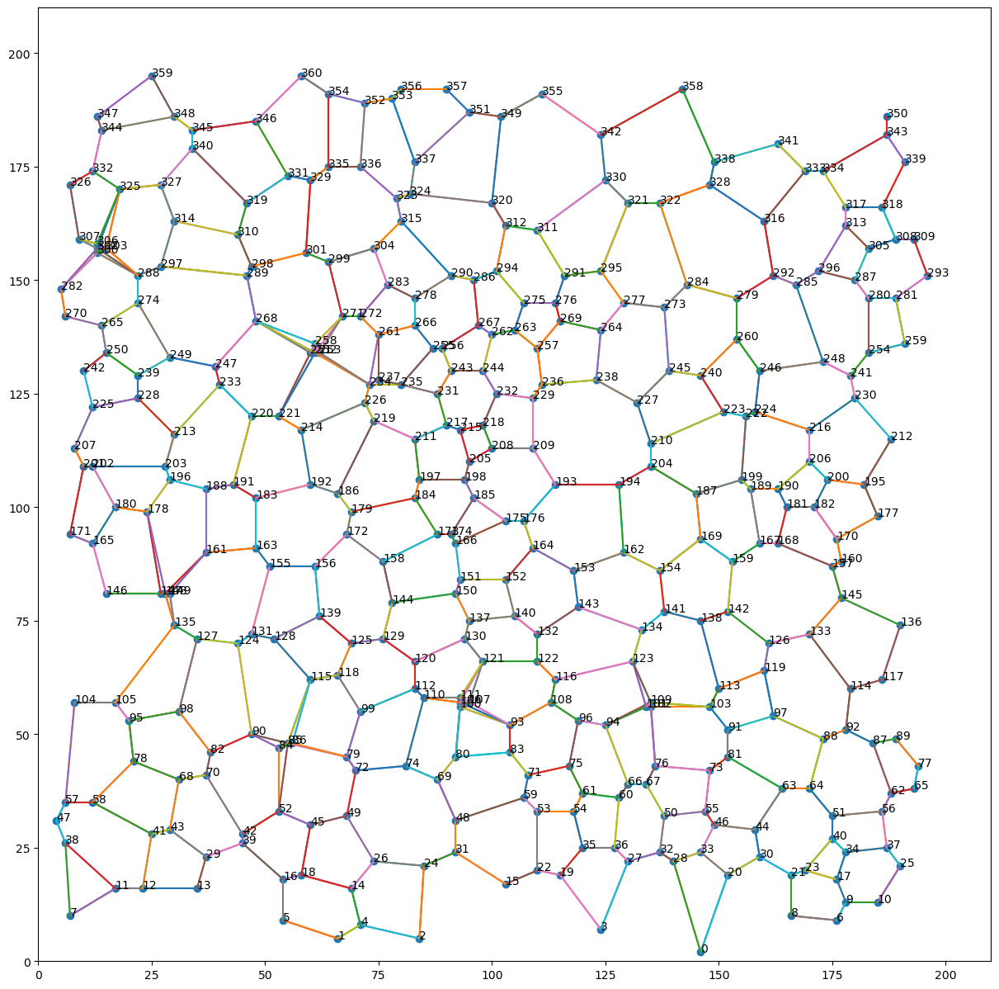

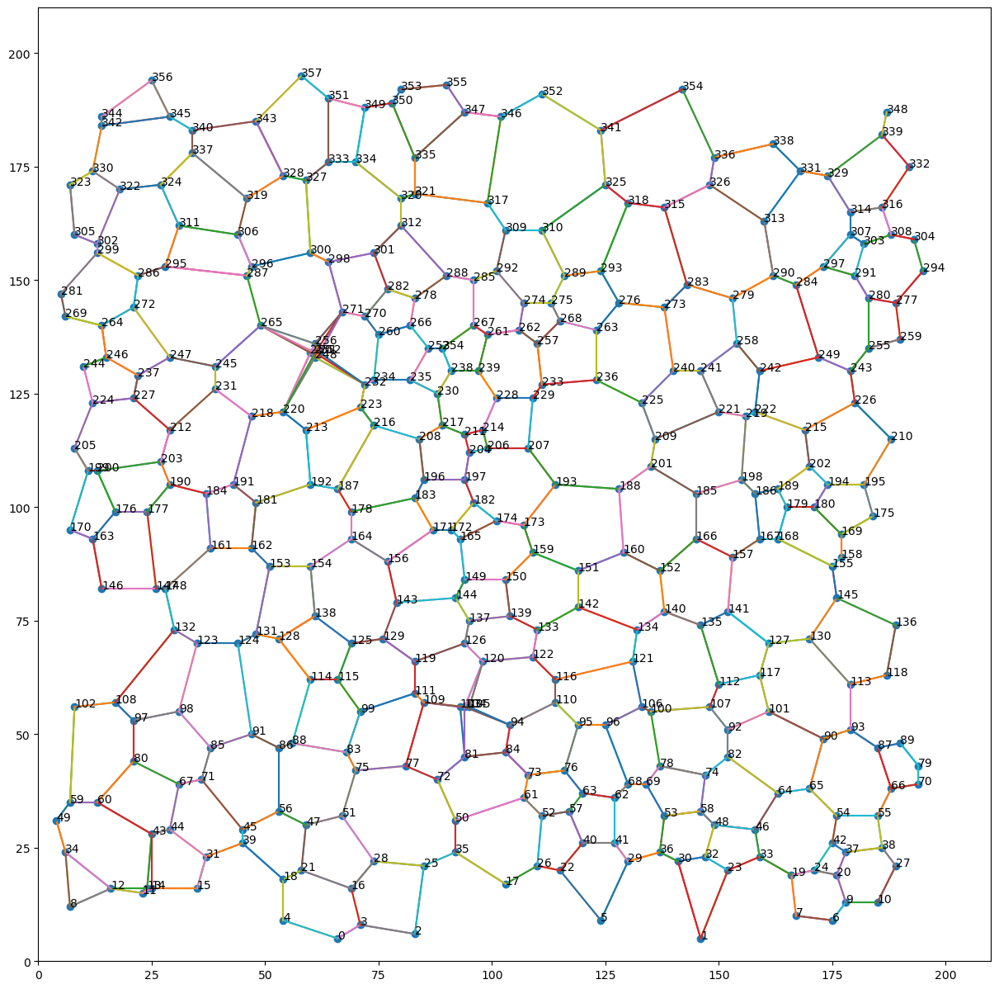

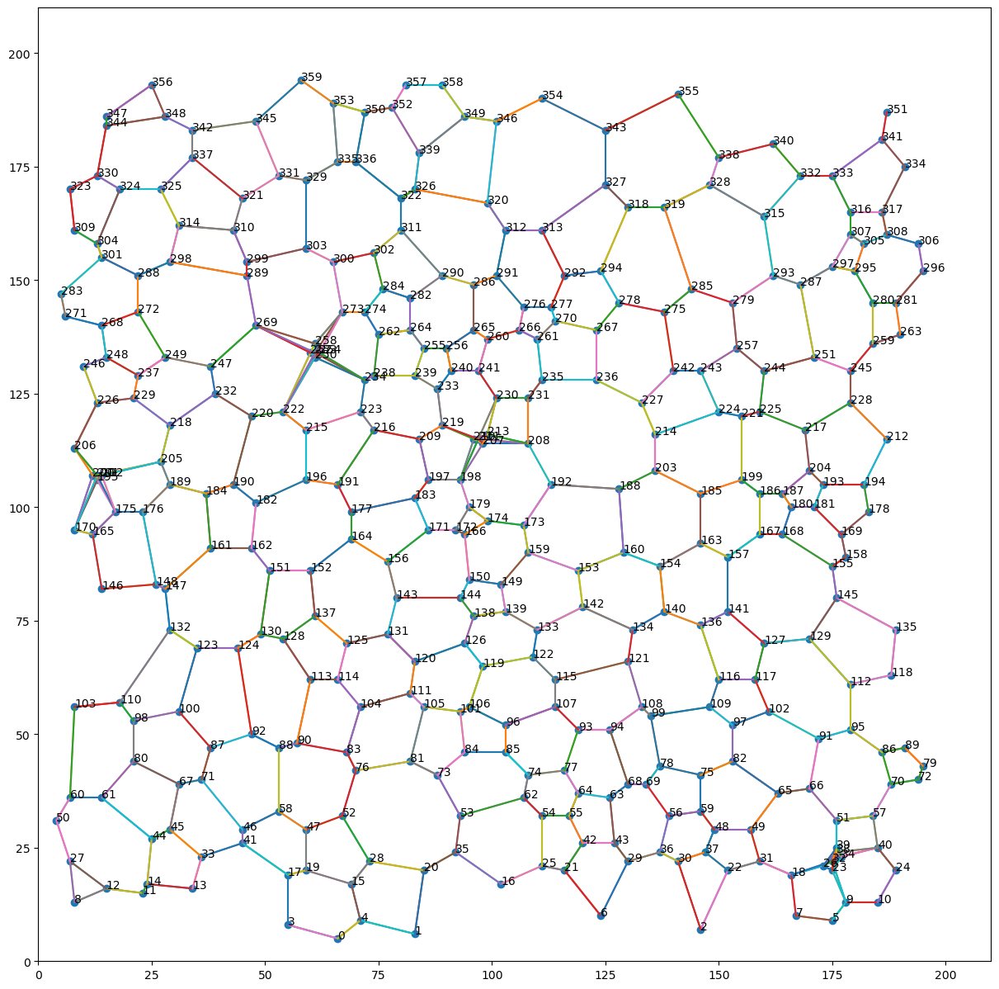

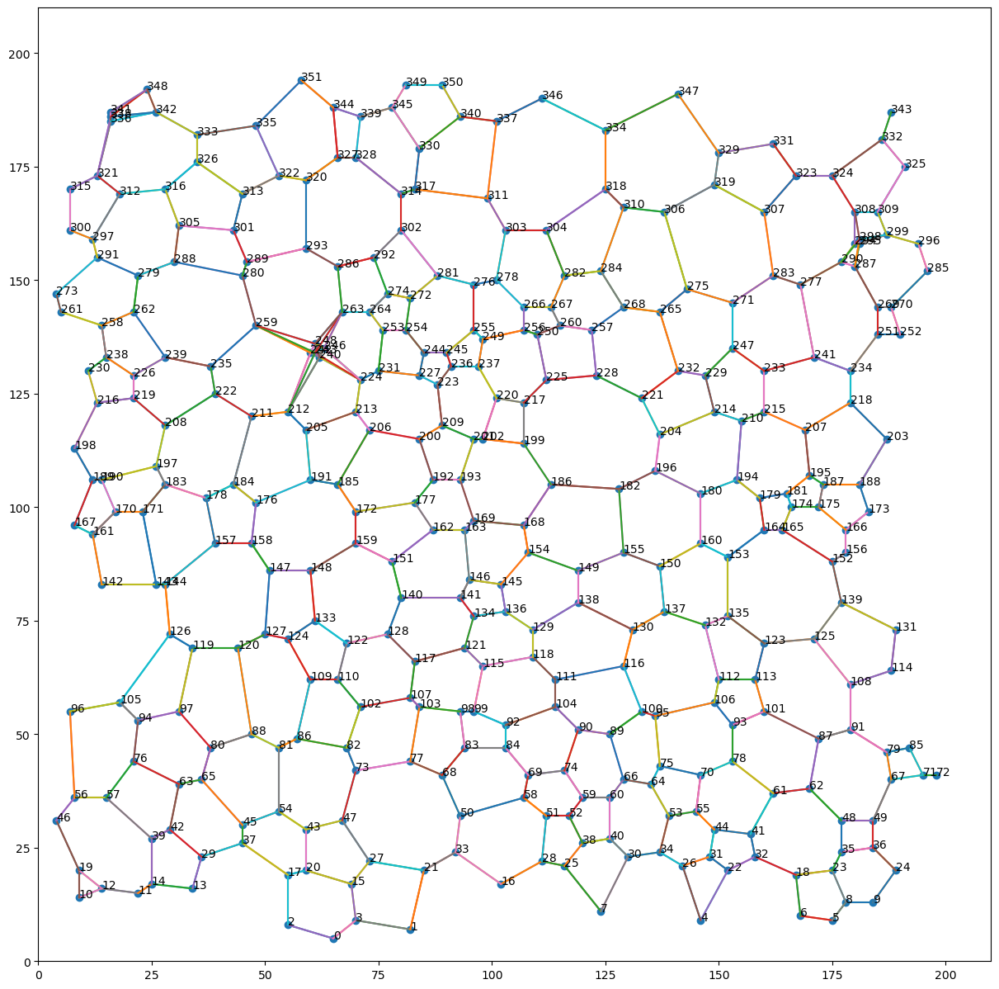

...

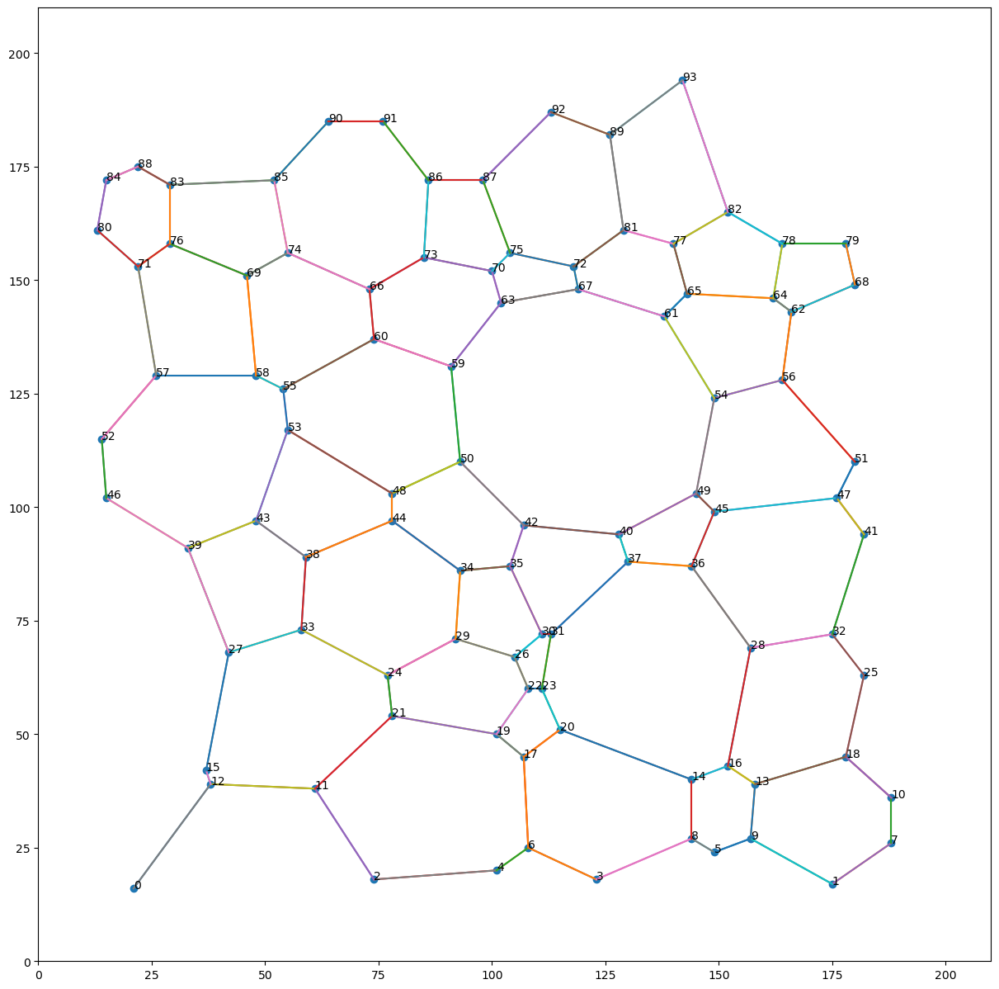

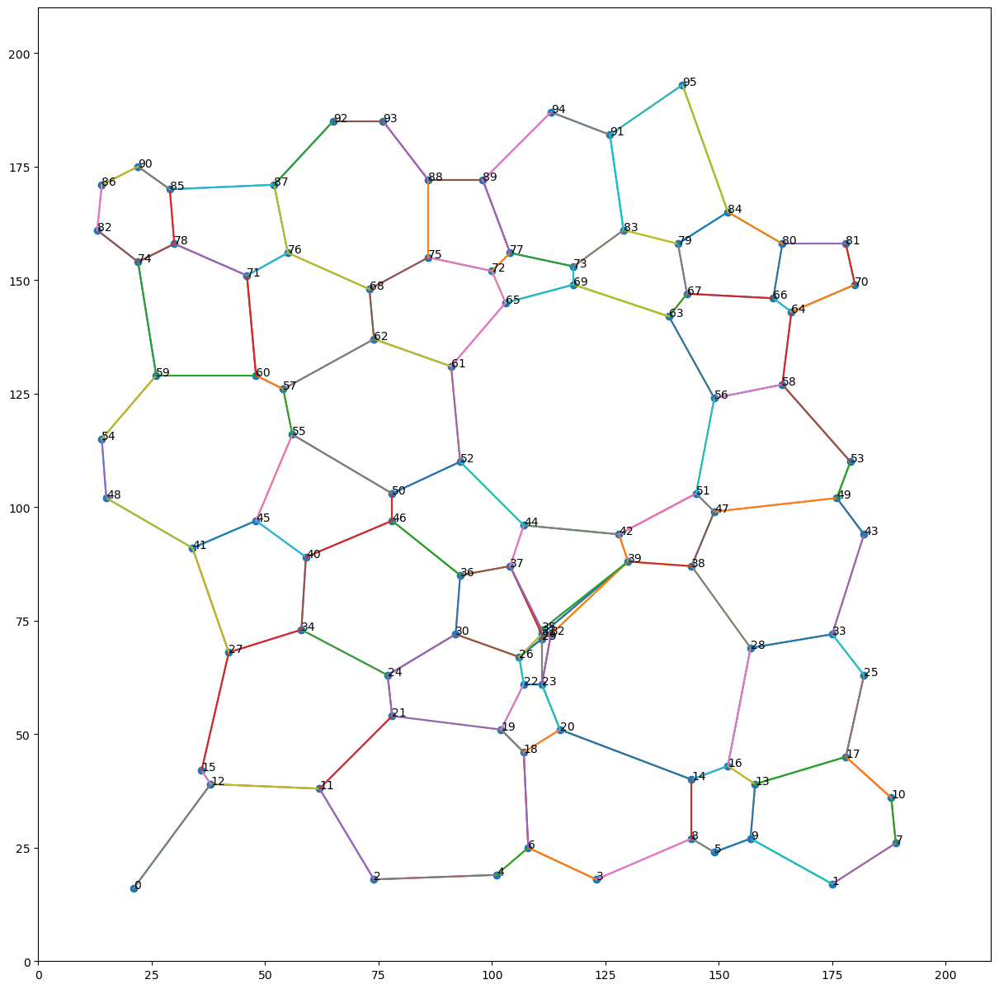

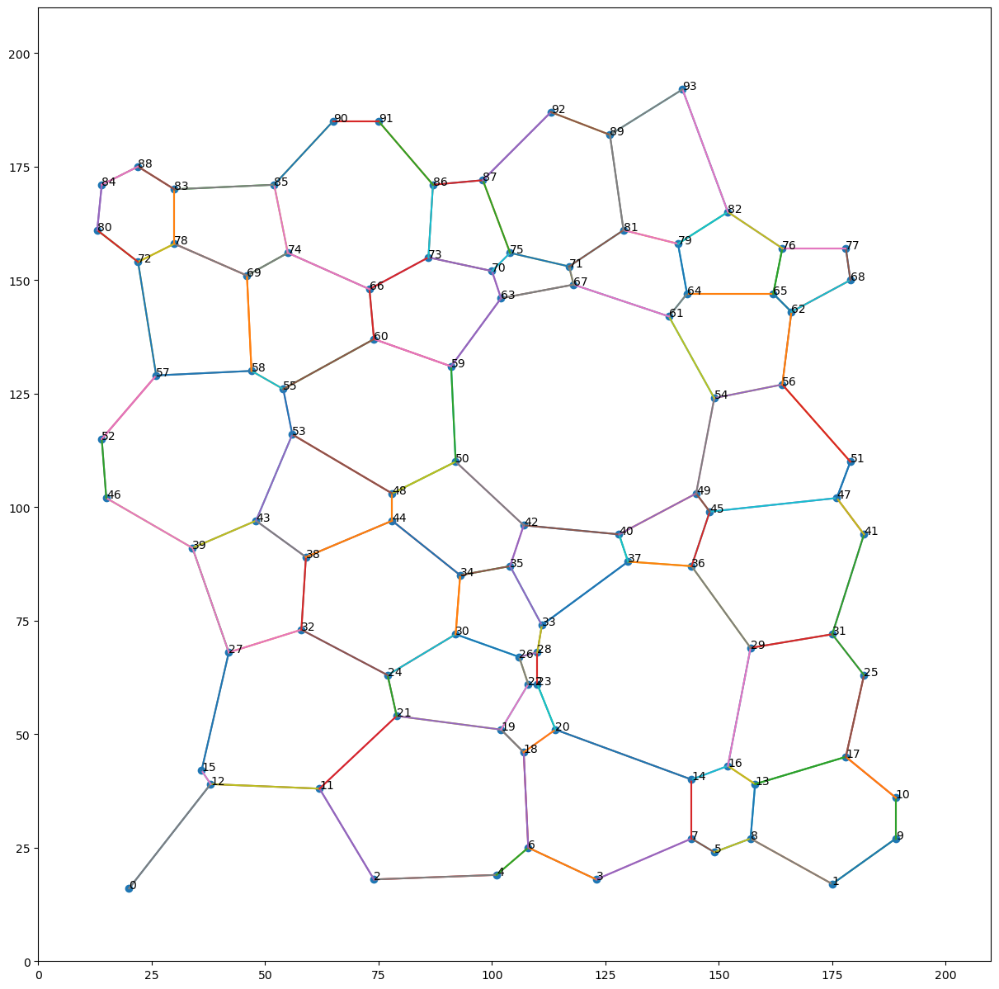

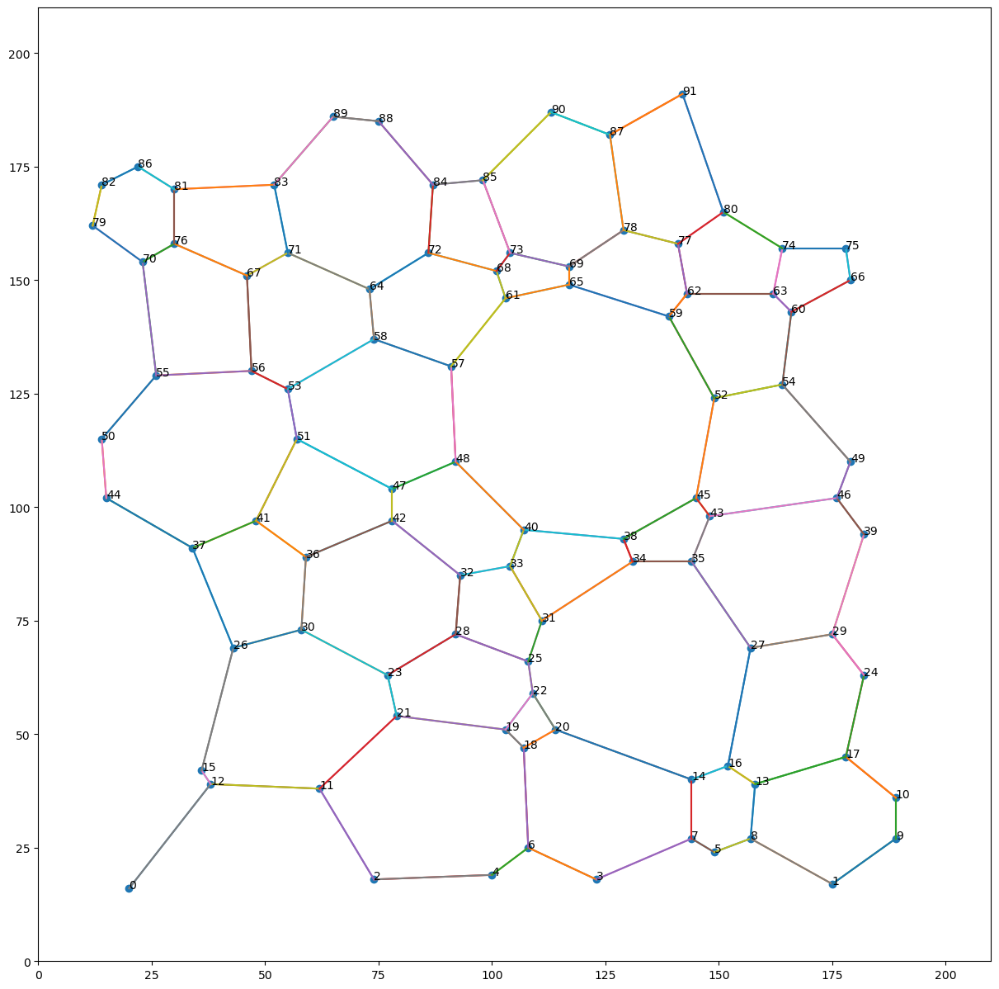

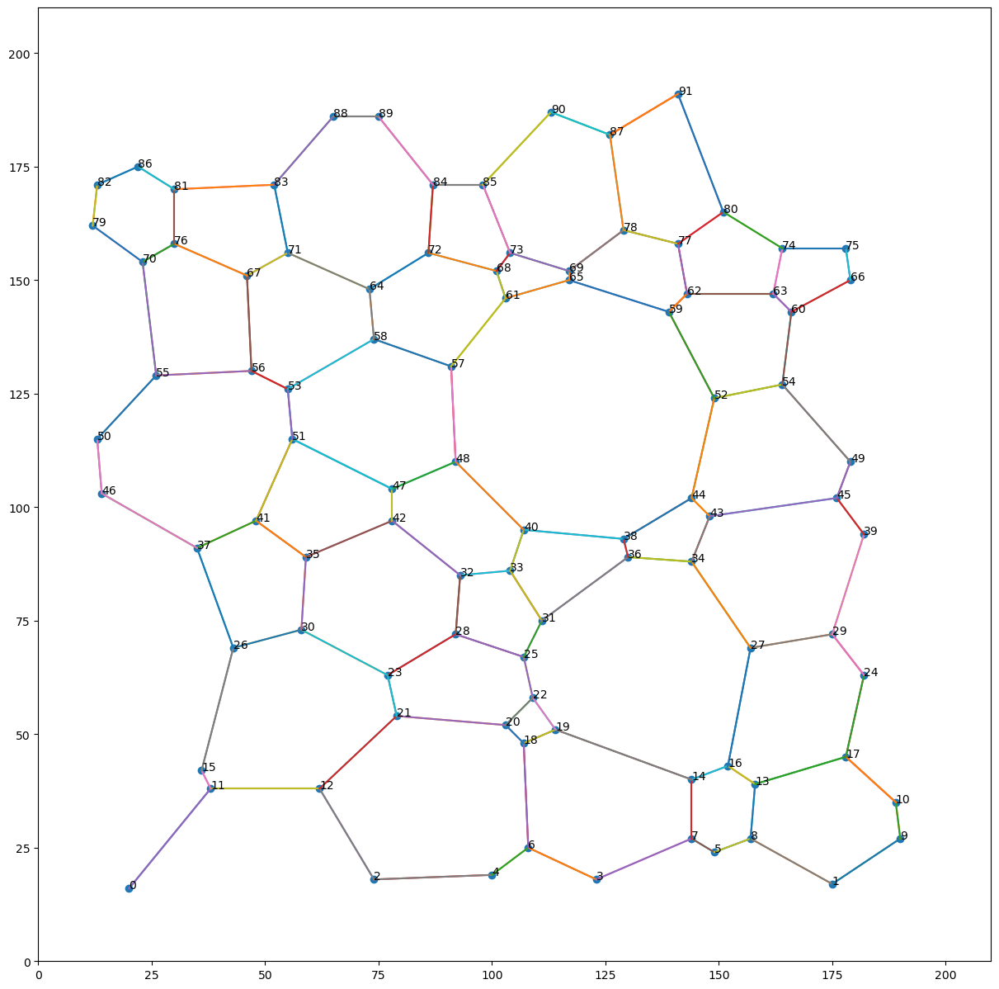

In [12]:
save_plots(tp, adj_mat)

In [13]:
with imageio.get_writer('plots/plots.gif', mode='I') as writer:
    for i in range(1, 60):
        filename = f'plots/plot_{i}.png'
        image = imageio.imread(filename)
        writer.append_data(image)

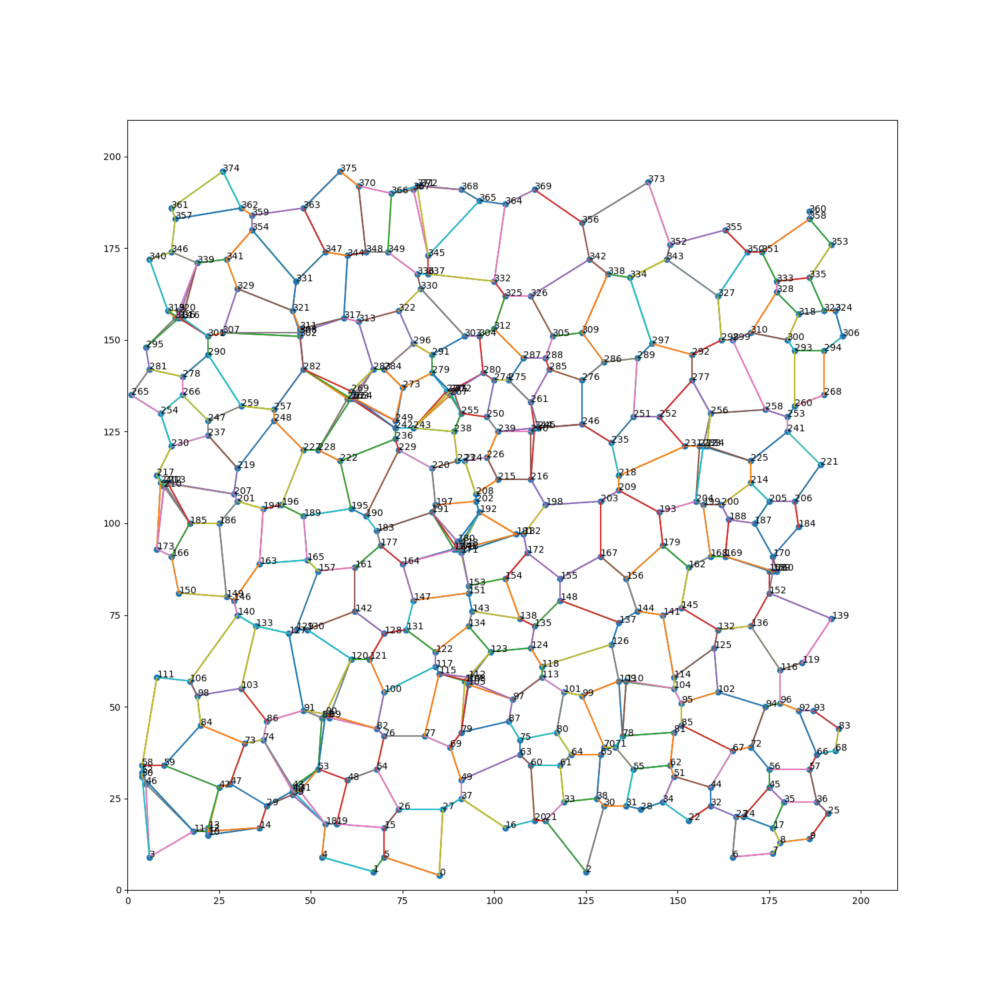

In [14]:
Image(filename='plots/plots.gif')

## Trajectory mapping

In [52]:
tp_dict = {}
for i in range(len(tp[1])):
    tp_dict[i] = [tp[1][i]]

In [55]:
mat = cdist(tp[1], tp[2])
min_ind = np.argmin(mat, axis = 1)
len(np.unique(min_ind))

348

In [84]:
t_0 = []
for i in range(1,60):
    t_0.append(tp[i][-10])
t = np.array(t_0)

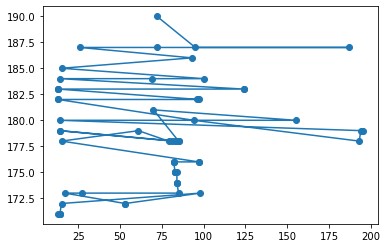

In [85]:
plt.plot(t[:,0], t[:,1], marker = 'o')


In [ ]:
plt.plot